# Visualization of accident patterns in Kiel

In this notebook we are going to dive deeper into accidents that happend in the Kieler area in Germany.
The data used for this notebook consists of 7 years reaching from 2016 to 2022 and contains 6772 entries.

Table of Content:
- Map of accidents in Kiel
- Accidents in Kiel by type and year
- time series of accidents in kiel
- accident type per weekday
- accidents per hour/month

Author: Martin J. Brucker
Student Number: 942815
Fachhochschule Kiel


In [261]:
# preperation for the analysis
import altair as alt
import geopandas as gpd
import pandas as pd

# setting configuration so dhat altari ignores max row limit
alt.data_transformers.disable_max_rows()

# importing the data
accidentsKiel = gpd.read_file("data/accidents.geojson")
districtsKiel = gpd.read_file("data/districts.geojson")
roadsKiel = gpd.read_file("data/roads.geojson")

# data preparation

# create a column with the year and month combined
accidentsKiel["year_month"] = accidentsKiel["year"].astype(str) + "-" + accidentsKiel["month"].astype(str)

accidentsKiel["year_month"] = pd.to_datetime(accidentsKiel["year_month"], format="%Y-%B")

# map of accidents in Kiel

# Accidents in Kiel by Type and Year

In the following diagram the number of accidents in Kiel is shown by type and year. The number of accidents is shown on the y-axis and the year on the x-axis. The different types of accidents are shown in different colors. The diagram shows that the number of accidents in Kiel has been decreasing since 2015. The number of accidents with injuries is the highest, followed by accidents with property damage and accidents with only material damage.

In [121]:
# Assuming 'year' is the column in your dataframe that contains the year information
melted_df = accidentsKiel.melt(value_vars=['bike', 'car', 'pedestrian', 'motorcycle', 'truck', 'other'], 
                               var_name='type', value_name='count', id_vars='year')

# Create an interactive Altair chart with tooltip and title
chart = alt.Chart(melted_df).mark_bar().encode(
    x=alt.X('type:N', sort='-y', title='Type of Accident'),
    y=alt.Y('count:Q', title='Count of Accidents'),
    color=alt.Color('year:N', title='Year of Accident'),
    tooltip=['type', 'year']  # Add tooltip
).properties(
    title='Accidents in Kiel by Type and Year'  # Add chart title
).interactive()

chart


alt.Chart(...)

# Time Series

In the following diagram a time Series with a count of accidents per month is represented.

In [212]:
# Pre-calculate the monthly counts of accidents in Kiel
monthly_accident_counts = accidentsKiel.groupby('year_month').size().reset_index(name='counts')

# Create a line chart to visualize the counts
line = alt.Chart(monthly_accident_counts).mark_line(color='blue').encode(
    x=alt.X('year_month:T', title='Year and Month'),
    y=alt.Y('counts:Q', title='Number of Accidents'),
    tooltip=['year_month:T', 'counts:Q']  # Add tooltips
)

# Create a LOESS line to show the trend
loess = line.transform_loess('year_month', 'counts', bandwidth=0.3).mark_line(color="red")

# Combine the line chart and the LOESS line
chart = line + loess 

# Improve aesthetics
chart = chart.properties(
    title='Accidents in Kiel Over Time',
    width=600,
    height=400
)

chart


alt.LayerChart(...)

### Interpretation of the Graph

The line graph illustrates the trend of accidents in Kiel over time, spanning from 2016 to end-2022. The blue line represents the monthly number of accidents, while the red line depicts a smoothed trend to better visualize long-term patterns.

#### Key Observations

- **Volatility**: The number of accidents each month is highly volatile, with noticeable peaks and troughs.
- **Trend Analysis**: Despite short-term fluctuations, the red trend line indicates a general decline in accidents over time.
- **Peak Accident Periods**: Notable spikes are observed around mid-2018 and early 2020.

#### Insights

This graph is instrumental for understanding accident trends in Kiel. It highlights periods with increased accident rates, aiding authorities and policymakers in identifying potential causes and implementing preventive measures. The declining trend suggests that overall safety might be improving or reporting mechanisms are changing.


# Accident Type per Weekday

In [183]:
# Calculate the total count for each weekday
total = accidentsKiel.groupby(['weekday']).size().reset_index(name='total')

# Calculate the count for each type1 for each weekday
type1_counts = accidentsKiel.groupby(['weekday', 'type1']).size().reset_index(name='count')

# Merge the two dataframes
merged = pd.merge(type1_counts, total, on='weekday')

# Calculate the percentage
merged['percentage'] = merged['count'] / merged['total']

# Create the chart
chart = alt.Chart(merged).mark_bar().encode(
    x=alt.X('weekday', title='Weekday'),
    y=alt.Y('percentage', axis=alt.Axis(format='%'), title='Percentage'),
    color='type1',
    tooltip=[alt.Tooltip('type1', title='Type 1'), alt.Tooltip('percentage', format='.2%', title='Percentage')]
).properties(
    title='Percentage Representation of Each Type1 per Weekday'
).interactive()

chart

alt.Chart(...)

### Interpretation of the Chart

The stacked bar chart represents the percentage representation of each type of accident occurring on different days of the week. Each color in the bars corresponds to a specific type of accident as indicated in the legend on the right.

#### Key Observations

- **Accident Diversity**: There is a diverse range of accidents happening every day, with collisions between vehicles and pedestrians being notably prevalent.
- **Weekend Trends**: On Saturday and Sunday, there's an observable increase in "Accident of another kind".
- **Midweek Patterns**: Collisions with another vehicle while changing lanes are more frequent during midweek.

#### Insights

This visual representation aids in quickly identifying patterns and anomalies related to accident occurrences on different weekdays. Such insights are crucial for implementing targeted safety measures to minimize specific types of accidents prevalent on particular days.


# Accidents per Hour/Month

In [254]:
# create chart
chart = alt.Chart(accidentsKiel).mark_rect().encode(
    x=alt.X('hour:O', title='Hour'),
    y=alt.Y('month:O', title='Month', sort=['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']),
    color=alt.Color('count():Q', title='Number of Accidents', scale=alt.Scale(scheme='redyellowblue', reverse=True)),
    tooltip=[alt.Tooltip('month:O', title='Month'), alt.Tooltip('hour:O', title='Hour'), alt.Tooltip('count():Q', title='Number of Accidents')]
).properties(
    title='Traffic Accidents in Kiel',
    width=600,
    height=400
).interactive()

# display chart
chart


alt.Chart(...)

### Interpretation of the Chart

The heatmap represents the frequency of traffic accidents in Kiel, categorized by month and hour of the day. The color intensity, ranging from blue (low) to red (high), indicates the number of accidents.

#### Key Observations

- **Nighttime Safety**: There is a significant reduction in accidents during the late night and early morning hours across all months.
- **April Afternoons**: In April, there is a noticeable spike in accidents around 15:00.
- **Consistency Across Months**: While there are variations, no single month stands out as having a significantly higher overall rate of accidents.

#### Insights

This visual data provides an understanding of when traffic accidents are most likely to occur in Kiel. It can be instrumental for law enforcement and city planners to implement safety measures, manage traffic flow, and perhaps increase patrols during high-risk hours or months. This information can also be useful for drivers, who can adjust their driving habits during these high-risk times to ensure their safety. 

Please note that the outlined cells in the heatmap seem significant, but without additional context or a legend for these outlines, their meaning is unclear. If these outlines represent additional data or highlight specific points of interest, including this information in the chart's tooltip or legend would be beneficial for the viewer. 


<Axes: >

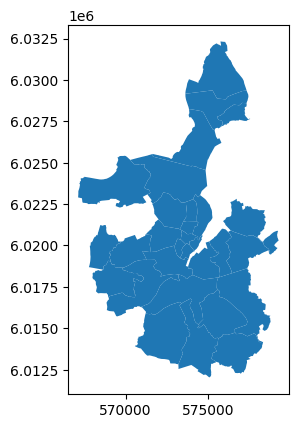

In [124]:
districtsKiel.plot()

In [125]:
districtsKiel.geometry = districtsKiel.geometry.scale(
    origin=(
        districtsKiel.geometry.centroid.x.mean(),
        districtsKiel.geometry.centroid.y.mean()
    )
)
alt.Chart(districtsKiel).mark_geoshape().encode(
    color="wikidata", tooltip=["district_name:N"]
).project("identity").properties(width=600, height=600)



alt.Chart(...)

In [126]:
accidentsKiel.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 6772 entries, 0 to 6771
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   year              6772 non-null   int64         
 1   month             6772 non-null   object        
 2   hour              6772 non-null   int64         
 3   weekday           6772 non-null   object        
 4   harm_type         6772 non-null   object        
 5   type1             6772 non-null   object        
 6   type2             6772 non-null   object        
 7   light_conditions  1389 non-null   object        
 8   bike              6772 non-null   object        
 9   car               6772 non-null   object        
 10  pedestrian        6772 non-null   object        
 11  motorcycle        6772 non-null   object        
 12  truck             5729 non-null   object        
 13  other             6772 non-null   object        
 14  geometry        

In [127]:
# anzahl der verschiedenen ausprägungen jedes attributes in accidentsKiel
accidentsKiel.nunique()

year                   7
month                 12
hour                  24
weekday                7
harm_type              3
type1                 10
type2                  7
light_conditions       2
bike                   2
car                    2
pedestrian             2
motorcycle             2
truck                  2
other                  2
geometry            6657
year_month            84
dtype: int64

In [148]:
# Define a large number greater than the maximum count
max_count = 1000  # Replace this with your actual maximum count

base = alt.Chart(accidentsKiel).transform_calculate(
    inverted_count=str(max_count) + ' - datum.count'
).encode(
    alt.Theta('harm_type:N'),
    alt.Radius('inverted_count:Q', scale=alt.Scale(type='sqrt', zero=True, rangeMin=20)),
    color='harm_type:N',
    tooltip=['harm_type:N', 'count():Q']
)

c1 = base.mark_arc(innerRadius=20, stroke='#fff')
c2 = base.mark_text(radiusOffset=10).encode(text='count():Q')

chart = c1 + c2
chart.interactive()  # Make the chart interactive


alt.LayerChart(...)

In [141]:
accidentsKiel["harm_type"]

0       Slightly Injured
1       Slightly Injured
2       Slightly Injured
3       Slightly Injured
4       Slightly Injured
              ...       
6767    Slightly Injured
6768    Slightly Injured
6769    Slightly Injured
6770    Severely Injured
6771    Slightly Injured
Name: harm_type, Length: 6772, dtype: object

In [129]:
# color: car, pedestrian, bike, truck, motorcycle
# y-axis hour
# x harm_type


hexagon = "M0,-2.3094010768L2,-1.1547005384 2,1.1547005384 0,2.3094010768 -2,1.1547005384 -2,-1.1547005384Z"

# Size of the hexbins
size = 15
# Count of distinct x features
xFeaturesCount = 12
# Count of distinct y features
yFeaturesCount = 7
# Name of the x field
xField = 'date'
# Name of the y field
yField = 'date'

# plot this with Altair
alt.Chart(accidentsKiel).mark_point(size=2, shape=hexagon).encode(
    x="hour",
    y="month",
    color="harm_type",
).transform_calculate(
    # This field is required for the hexagonal X-Offset
    xFeaturePos='(day(datum.' + yField + ') % 2) / 2 + month(datum.' + xField + ')'
).properties(
    # Exact scaling factors to make the hexbins fit
    width=size * xFeaturesCount * 2,
    height=size * yFeaturesCount * 1.7320508076,  # 1.7320508076 is approx. sin(60°)*2
).configure_view(
    strokeWidth=0
)




alt.Chart(...)

In [130]:

# create chart
chart = alt.Chart(accidentsKiel).mark_circle().encode(
    x=alt.X('hour:O', title='Stunde'),
    y=alt.Y('month:O', title='Monat'),
    color=alt.Color('count():Q', title='Anzahl der Unfälle', scale=alt.Scale(scheme='redyellowblue')),
    size=alt.Size('harm_type:N', title='Schadensart')
).properties(
    title='Verkehrsunfälle in Kiel im Jahr 2019',
    width=600,
    height=400
).interactive()

# display chart
chart


alt.Chart(...)

In [131]:
# Create the chart
chart = alt.Chart(accidentsKiel[accidentsKiel["year"] == 2022]).mark_bar().encode(
    x='harm_type:N',
    y='hour',
    color='vehicle_type:N'  # Assuming the column name for vehicle type is 'vehicle_type'
)

chart

alt.Chart(...)

In [132]:
import altair as alt
import pandas as pd

# Melt the dataframe to have a column for types and a column for counts
melted_df = accidentsKiel.melt(value_vars=['bike', 'car', 'pedestrian', 'motorcycle', 'truck', 'other'], 
                               var_name='type', value_name='count')

# Create an Altair chart
chart = alt.Chart(melted_df).mark_bar().encode(
    x=alt.X('type:N', sort='-y'),
    y='count:Q',
)

chart

alt.Chart(...)

In [177]:
# count for each unique value in type1 and type2
accidentsKiel.groupby(["type1"]).size()

#plot a altari diagram for each type1 and weekday
alt.Chart(accidentsKiel).mark_bar().encode(
    x='weekday',
    y='count()',
    color='type1'
).interactive()

alt.Chart(...)

In [172]:
import altair as alt
import pandas as pd

# Assuming you have a DataFrame 'df' with fields 'angle_field', 'radius_field', and 'color_field'
base = alt.Chart(accidentsKiel).encode(
    theta='angle_field:Q',
    radius='radius_field:Q',
    color='color_field:N'
)

arc = base.mark_arc(innerRadius=20, stroke="#fff")
text = base.mark_text(radiusOffset=10).encode(text='radius_field:Q')

chart = arc + text
chart


alt.LayerChart(...)

In [204]:
import altair as alt
import pandas as pd

# Pre-calculate the counts
accidentsKiel_counts = accidentsKiel.groupby('year_month').size().reset_index(name='counts')

# Create a line chart
line = alt.Chart(accidentsKiel_counts).mark_line().encode(
    x='year_month:T',
    y='counts:Q',
    tooltip=['year_month:T', 'counts:Q']  # Add tooltips
)

# Create a LOESS line
loess = line.transform_loess('year_month', 'counts', bandwidth=0.3).mark_line(color="red")


# Combine the line chart and the LOESS line
chart = line + loess 

# Improve aesthetics
chart = chart.properties(
    title='Accidents in Kiel Over Time',
    width=800,
    height=400
)

chart


alt.LayerChart(...)

In [205]:
import altair as alt
import pandas as pd

# Pre-calculate the monthly counts of accidents in Kiel
monthly_accident_counts = accidentsKiel.groupby('year_month').size().reset_index(name='counts')

# Create a line chart to visualize the counts
line = alt.Chart(monthly_accident_counts).mark_line(color='blue').encode(
    x=alt.X('year_month:T', title='Year and Month'),
    y=alt.Y('counts:Q', title='Number of Accidents'),
    tooltip=['year_month:T', 'counts:Q']  # Add tooltips
)

# Create a LOESS line to show the trend
loess = line.transform_loess('year_month', 'counts', bandwidth=0.3).mark_line(color="red")

# Combine the line chart and the LOESS line
chart = line + loess 

# Improve aesthetics
chart = chart.properties(
    title='Accidents in Kiel Over Time',
    width=600,
    height=400
)

chart


alt.LayerChart(...)

In [206]:
import altair as alt
import pandas as pd

# Pre-calculate the monthly counts of accidents in Kiel
monthly_accident_counts = accidentsKiel.groupby('year_month').size().reset_index(name='counts')

# Create a line chart to visualize the counts
line = alt.Chart(monthly_accident_counts).mark_line(color='blue', size=3).encode(
    x=alt.X('year_month:T', title='Year and Month'),
    y=alt.Y('counts:Q', title='Number of Accidents', scale=alt.Scale(zero=False)),
    tooltip=['year_month:T', 'counts:Q']  # Add tooltips
).interactive()

# Create a LOESS line to show the trend
loess = line.transform_loess('year_month', 'counts', bandwidth=0.3).mark_line(color="red", size=3)

# Combine the line chart and the LOESS line
chart = line + loess 

# Improve aesthetics
chart = chart.properties(
    title='Accidents in Kiel Over Time',
    width=600,
    height=400
)

chart


alt.LayerChart(...)

In [210]:
# Pre-calculate the monthly counts of all accidents and bike accidents in Kiel
monthly_all_accident_counts = accidentsKiel.groupby('year_month').size().reset_index(name='counts')
monthly_bike_accident_counts = accidentsKiel[accidentsKiel['bike'] == 1].groupby('year_month').size().reset_index(name='bike_counts')

# Create a line chart to visualize the counts of all accidents
line_all = alt.Chart(monthly_all_accident_counts).mark_line(color='blue', size=3).encode(
    x=alt.X('year_month:T', title='Year and Month'),
    y=alt.Y('counts:Q', title='Number of Accidents', scale=alt.Scale(zero=False))
)

# Create a line chart to visualize the counts of bike accidents
line_bike = alt.Chart(monthly_bike_accident_counts).mark_line(color='green', size=3).encode(
    x='year_month:T',
    y='bike_counts:Q'
)

# Create a LOESS line to show the trend of all accidents
loess_all = line_all.transform_loess('year_month', 'counts', bandwidth=0.3).mark_line(color="red", size=3)

# Combine the line charts and the LOESS line
chart = line_all + line_bike + loess_all

# Make the combined chart interactive
chart = chart.interactive()

# Improve aesthetics
chart = chart.properties(
    title='Accidents in Kiel Over Time',
    width=600,
    height=400
)

chart


alt.LayerChart(...)

In [225]:
# create chart
chart = alt.Chart(accidentsKiel).mark_rect().encode(
    x=alt.X('hour:O', title='Hour'),
    y=alt.Y('month:O', title='Month', sort=['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']),
    color=alt.Color('count():Q', title='Number of Accidents', scale=alt.Scale(scheme='redyellowblue', reverse=True)),
    tooltip=[alt.Tooltip('month:O', title='Month'), alt.Tooltip('hour:O', title='Hour'), alt.Tooltip('count():Q', title='Number of Accidents')]
).properties(
    title='Traffic Accidents in Kiel',
    width=600,
    height=400
).interactive()

# display chart
chart


alt.Chart(...)

In [244]:
# Convert the 'month' column to a categorical data type with the desired order
accidentsKiel['month'] = pd.Categorical(accidentsKiel['month'], categories=['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December'], ordered=True)

# create base chart
base = alt.Chart(accidentsKiel).mark_rect().encode(
    x=alt.X('hour:O', title='Hour'),
    y=alt.Y('month:O', title='Month', sort=alt.EncodingSortField(field="month", op="min", order='ascending')),  # Sort the 'month' field
    color=alt.Color('count():Q', title='Number of Accidents', scale=alt.Scale(scheme='redyellowblue', reverse=True)),
    tooltip=[alt.Tooltip('month:O', title='Month'), alt.Tooltip('hour:O', title='Hour'), alt.Tooltip('count():Q', title='Number of Accidents')]
)

# create layer for accidents where harm_type is "Killed"
killed_layer = alt.Chart(accidentsKiel[accidentsKiel['harm_type'] == 'Killed']).mark_rect(fill=None, stroke='black', strokeWidth=2).encode(
    x='hour:O',
    y=alt.Y('month:O', sort=alt.EncodingSortField(field="month", op="min", order='ascending'))  # Sort the 'month' field in the 'killed_layer'
)

# combine base chart, killed_layer
chart = alt.layer(base, killed_layer).properties(
    title='Traffic Accidents in Kiel',
    width=600,
    height=400
).interactive()

# display chart
chart


alt.LayerChart(...)

In [284]:
import geopandas as gpd

# Load the GeoJSON files
accidents_gdf = gpd.read_file('data/accidents.geojson')
districts_gdf = gpd.read_file('data/districts.geojson')
roads_gdf = gpd.read_file('data/roads.geojson')

import json

# Convert GeoDataFrames to json
kiel_accidents_json = json.loads(accidents_gdf.to_json())
districts_json = json.loads(districts_gdf.to_json())
roads_json = json.loads(roadsKiel.to_json())

# Create an Altair data object for accidents
accidents_data = alt.Data(values=kiel_accidents_json['features'])

# Create an Altair data object for districts
districts_data = alt.Data(values=districts_json['features'])

# Create the base map layer
base_map = alt.Chart(alt.InlineData(values=districts_json)).mark_geoshape(
    fill='lightgray',
    stroke='white'
).properties(
    width=800,
    height=600
).project('identity', reflectY=True)

# Create the accidents layer
accidents_layer = alt.Chart(alt.InlineData(values=kiel_accidents_json['features'])).mark_circle(
    size=50,
    color='red',
    opacity=0.5
).encode(
    longitude='geometry.coordinates[0]:Q',
    latitude='geometry.coordinates[1]:Q'
)

# Combine the layers
kiel_map = base_map + accidents_layer

# Save the map to an HTML file
kiel_map

alt.LayerChart(...)

In [289]:
import geopandas as gpd
import json
import altair as alt

# Load the GeoJSON files
accidents_gdf = gpd.read_file('data/accidents.geojson')
districts_gdf = gpd.read_file('data/districts.geojson')
roads_gdf = gpd.read_file('data/roads.geojson')

# Convert GeoDataFrames to json
kiel_accidents_json = json.loads(accidents_gdf.to_json())
districts_json = json.loads(districts_gdf.to_json())
roads_json = json.loads(roads_gdf.to_json())

# Create an Altair data object for accidents
accidents_data = alt.Data(values=kiel_accidents_json['features'])

# Create an Altair data object for districts
districts_data = alt.Data(values=districts_json['features'])

# Create the base map layer
base_map = alt.Chart(alt.InlineData(values=districts_json)).mark_geoshape(
    fill='lightgray',
    stroke='white'
).properties(
    width=800,
    height=600
).project('identity', reflectY=True)

# Create the accidents layer
accidents_layer = alt.Chart(alt.InlineData(values=kiel_accidents_json['features'])).mark_bar(
    size=10,
    color='red',
    opacity=0.5
).encode(
    x=alt.X('longitude:Q', bin=True),
    y=alt.Y('latitude:Q', bin=True),
    color=alt.Color('count():Q', scale=alt.Scale(scheme='reds')),
    tooltip='count()'
)

# Combine the layers
kiel_map = base_map + accidents_layer

# Save the map to an HTML file
kiel_map


alt.LayerChart(...)

In [297]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

# Load the GeoJSON files
accidents = gpd.read_file('data/accidents.geojson')
districts = gpd.read_file('data/districts.geojson')

# Merge the accidents data with the districts
accidents['count'] = 1
accidents_per_district = accidents.dissolve(by='district', aggfunc='count')

# Join the data with the districts GeoDataFrame
choropleth_data = districts.merge(accidents_per_district, on='district', how='left')

# Plotting the Choropleth map
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
choropleth_data.plot(column='count', ax=ax, legend=True, cmap='OrRd')
ctx.add_basemap(ax, crs=choropleth_data.crs.to_string(), source=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.show()

KeyError: 'district'

In [300]:
# Let's first check the columns of both GeoJSON files to understand the issue.
import geopandas as gpd

# Load the GeoJSON files
accidents = gpd.read_file('data/accidents.geojson')
districts = gpd.read_file('data/districts.geojson')

# Print the columns of both dataframes
districts_columns = districts.columns.tolist()
accidents_columns = accidents.columns.tolist()

print('Districts columns:', districts_columns)
print('Accidents columns:', accidents_columns)

Districts columns: ['osmid', 'name', 'wikidata', 'geometry']
Accidents columns: ['year', 'month', 'hour', 'weekday', 'harm_type', 'type1', 'type2', 'light_conditions', 'bike', 'car', 'pedestrian', 'motorcycle', 'truck', 'other', 'geometry']


/home/mbrucker/sem1/sem1_data_vis_and_vis_anal/.venv/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3488: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


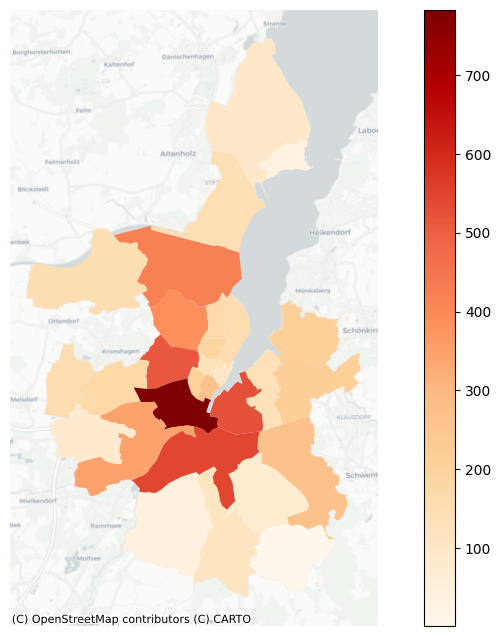

In [301]:
# Convert the accidents_count dataframe to a GeoDataFrame
import geopandas as gpd

# We need to set the geometry again for the accidents_count dataframe
accidents_count = gpd.GeoDataFrame(accidents_count, geometry='point')

# Now let's try the spatial join again
accidents_per_district = gpd.sjoin(accidents_count, districts, how='inner', op='within')

# Continue with the previous code
# Group by district name to get the total count of accidents per district
accidents_per_district = accidents_per_district.groupby('name').agg({'count':'sum'}).reset_index()

# Merge the accidents_per_district with the districts dataframe
choropleth_data = districts.merge(accidents_per_district, left_on='name', right_on='name', how='left')

# Plotting the Choropleth map
fig, ax = plt.subplots(1, 1, figsize=(12, 8))
choropleth_data.plot(column='count', ax=ax, legend=True, cmap='OrRd', missing_kwds={
    'color': 'lightgrey',
    'edgecolor': 'red',
    'hatch': '///',
    'label': 'Missing values'
})
ctx.add_basemap(ax, crs=choropleth_data.crs.to_string(), source=ctx.providers.CartoDB.Positron)
plt.axis('off')
plt.show()

In [304]:
import altair as alt
import geopandas as gpd
import pandas as pd

# Convert the accidents_count dataframe to a GeoDataFrame
accidents_count = gpd.GeoDataFrame(accidents_count, geometry='point')

# Now let's try the spatial join again
accidents_per_district = gpd.sjoin(accidents_count, districts, how='inner', op='within')

# Continue with the previous code
# Group by district name to get the total count of accidents per district
accidents_per_district = accidents_per_district.groupby('name').agg({'count':'sum'}).reset_index()

# Merge the accidents_per_district with the districts dataframe
choropleth_data = districts.merge(accidents_per_district, left_on='name', right_on='name', how='left')

# Create the Altair chart
alt.Chart(choropleth_data).mark_geoshape(
    stroke='black',
    strokeWidth=0.5
).encode(
    color=alt.Color('count:Q', scale=alt.Scale(scheme='orangered')),
    tooltip=['name:N', 'count:Q']
).properties(
    width=500,
    height=300
).project(
    type='identity', 
    reflectY=True
)


/home/mbrucker/sem1/sem1_data_vis_and_vis_anal/.venv/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3488: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


alt.Chart(...)